In [39]:
%load_ext autoreload
%reload_ext autoreload

%autoreload 2
%matplotlib inline
import matplotlib 
from matplotlib import pyplot as plt
import pandas as pd 
import pickle
import pybedtools 
import numpy as np 
from scipy.stats import gmean

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [40]:
cell="GM12878"

In [2]:
background_hits=pickle.load(open("../interpret/6dil/"+cell+".DNASE.bias_corrected_bpnet_tobias.unplugged.SHUFFLED.fold0.deepSHAP",'rb'))

In [3]:
foreground_hits=pickle.load(open("../interpret/6dil/"+cell+".DNASE.bias_corrected_bpnet_tobias.fold0.deepSHAP",'rb'))

In [4]:
foreground_shap=foreground_hits['profile_shap']
foreground_seq=foreground_hits['seq']
foreground_shap_scaled={} 
for key in foreground_shap: 
    foreground_shap_scaled[key]=np.sum(foreground_shap[key]*foreground_seq[key],axis=1)

In [5]:
background_shap=background_hits['profile_shap']
keys=list(background_shap.keys())
import random 
random.seed(1234)
key_subset=random.sample(keys,10000)
background_flat=[] 
for key in key_subset: 
    background_flat=background_flat+background_shap[key].tolist()

KeyboardInterrupt: 

In [9]:
background_flat=np.asarray(background_flat)

In [11]:
#restrict to only positive scores 
background_flat=background_flat[background_flat>=0]

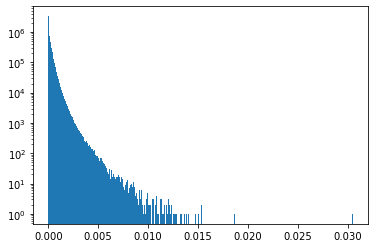

In [15]:
#plot the background distribution 
plt.hist(background_flat,bins=1000)
plt.yscale("log")
plt.title(cell+" shuffled background profile deepSHAP")
plt.savefig(cell+".shuffled.background.profile.deepshap.png")

In [16]:
from statsmodels.distributions.empirical_distribution import ECDF

In [17]:
ecdf=ECDF(abs(background_flat))

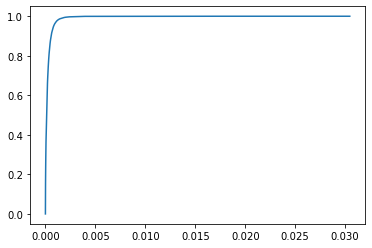

In [18]:
plt.plot(ecdf.x, ecdf.y)
plt.title(cell+" shuffled background profile deepSHAP CDF")
plt.savefig(cell+".shuffled.background.profile.deepshap.cdf.png")

In [20]:
#pickle the background scores 
import pickle 
# open a file, where you ant to store the data
file = open(cell+'.dnase.background.deepshap.ecdf.pickle', 'wb')
# dump information to that file
pickle.dump(ecdf, file)
file.close()

In [36]:
intersections=pd.read_csv(cell+'.idr.peaks.50bp.around.summit.overlap.tf.all.bed',header=None,sep='\t')


In [37]:
intersections.head()

,0,1,2,3,4,5,6,7,8,9,10,11
0,chr1,629096,629110,SIX4_MOUSE.H11MO.0.C,9.077500,-,AGTCTCAGGCTTCA,chr1,629103,629203,629153,7
1,chr1,629097,629113,SIX2_MA1119.1,8.536966,-,GTCTCAGGCTTCAACA,chr1,629103,629203,629153,10
2,chr1,629118,629133,AP2A_HUMAN.H11MO.0.A,7.563299,-,TACGCCGCAGGCCCC,chr1,629103,629203,629153,15
3,chr1,629118,629140,SP1_HUMAN.H11MO.0.A,6.461498,-,TACGCCGCAGGCCCCTTCGCCC,chr1,629103,629203,629153,22
4,chr1,629119,629132,AP2C_MOUSE.H11MO.0.A,9.684639,+,ACGCCGCAGGCCC,chr1,629103,629203,629153,13


In [ ]:
import pdb
tf_to_geom_mean_pval={} 
tf_to_90_percentile_pval={} 
tf_to_pval_of_mean={} 
outf=open(cell+".tf.sig.tsv",'w')
count=0 
for key in foreground_shap_scaled: 
    if count %100==0: 
        print(str(count))
    count+=1
    chrom=key[0]
    summit=key[1] 
    deepshap_vals=foreground_shap_scaled[key]
    #change negative values to 0; not associated w/ predictive instances  
    deepshap_vals[deepshap_vals<0]=0 
    #get empirical p-values 
    deepshap_pvals=1-ecdf(abs(deepshap_vals))

    hits=intersections[(intersections[7]==chrom) & (intersections[10]==summit)]
    num_hits=hits.shape[0]
    tf_names=hits[3]
    tf_start=672+hits[1]-hits[10]
    tf_end=672+hits[2]-hits[10]
    for i in range(num_hits): 
        cur_tf=tf_names.iloc[i]
        cur_tf_start=tf_start.iloc[i] 
        cur_tf_end=tf_end.iloc[i]
        if cur_tf not in tf_to_geom_mean_pval: 
            tf_to_geom_mean_pval[cur_tf]=[]
            tf_to_90_percentile_pval[cur_tf]=[]
            tf_to_pval_of_mean[cur_tf]=[] 
            
        #pvalue of the mean deepSHAP score,make sure pval >=1e-320 to avoid numerical precision issues with log 
        pval_of_mean=max([1-ecdf(np.mean(deepshap_vals[cur_tf_start:cur_tf_end])),1e-320])
        geom_mean_pval=max([gmean(deepshap_pvals[cur_tf_start:cur_tf_end]),1e-320])
        pval_90_percentile=max([np.percentile(deepshap_pvals[cur_tf_start:cur_tf_end],90),1e-320])
        
        #compute -log10(pval)
        pval_of_mean=-1*np.log10(pval_of_mean)
        geom_mean_pval=-1*np.log10(geom_mean_pval)
        pval_90_percentile=-1*np.log10(pval_90_percentile)
        
        
        #append to list for distribution 
        tf_to_pval_of_mean[cur_tf].append(pval_of_mean)
        tf_to_geom_mean_pval[cur_tf].append(geom_mean_pval)
        tf_to_90_percentile_pval[cur_tf].append(pval_90_percentile)
        #keep track of significant hits 
        if max([pval_of_mean,geom_mean_pval,pval_90_percentile]) > 2: 
            outf.write(chrom+'\t'+str(hits[1].iloc[i])+'\t'+str(hits[2].iloc[i])+'\t'+str(hits[5].iloc[i])+'\t'+cur_tf+'\t'+str(round(pval_of_mean,2))+'\t'+str(round(geom_mean_pval,2))+'\t'+str(round(pval_90_percentile,2))+'\n')
outf.close()

0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
11400
11500
11600
11700
11800
11900
12000
12100
12200
12300
12400
12500
12600
12700
12800
12900
13000
13100
13200
13300
13400
13500
13600


In [47]:
import pickle
with open(cell+'.tfscan.tf_to_geom_mean_pval.pickle', 'wb') as handle:
    pickle.dump(tf_to_geom_mean_pval, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open(cell+'.tfscan.tf_to_90_percentile_pval.pickle', 'wb') as handle:
    pickle.dump(tf_to_90_percentile_pval, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open(cell+'.tfscan.tf_to_pval_of_mean.pickle', 'wb') as handle:
    pickle.dump(tf_to_pval_of_mean, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [48]:
keys=list(tf_to_geom_mean_pval.keys())
keys.sort()

In [49]:
%matplotlib inline 
import matplotlib 
from matplotlib import pyplot as plt 



AHR_HUMAN.H11MO.0.B
AHR_MOUSE.H11MO.0.B
AIRE_HUMAN.H11MO.0.C
AIRE_MOUSE.H11MO.0.C
ALX1_HUMAN.H11MO.0.B
ALX1_MOUSE.H11MO.0.B
ALX3_MA0634.1
ALX3_homeodomain_1
ALX3_homeodomain_2
ALX3_homeodomain_3
ALX4_homeodomain_1
ANDR_HUMAN.H11MO.0.A
ANDR_MOUSE.H11MO.0.A
AP2A_HUMAN.H11MO.0.A
AP2A_MOUSE.H11MO.0.A
AP2B_HUMAN.H11MO.0.B
AP2B_MOUSE.H11MO.0.B
AP2C_HUMAN.H11MO.0.A
AP2C_MOUSE.H11MO.0.A
ARI5B_HUMAN.H11MO.0.C
ARI5B_MOUSE.H11MO.0.C


/users/annashch/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


ARNT+HIF1A_MA0259.1
ARNTL_bHLH_1
ARNT_HUMAN.H11MO.0.B
ARNT_MOUSE.H11MO.0.B
ARX_homeodomain_1
AR_nuclearreceptor_1
AR_nuclearreceptor_2
ASCL1_HUMAN.H11MO.0.A
ASCL1_MA1100.1
ASCL1_MOUSE.H11MO.0.A
ASCL2_MOUSE.H11MO.0.C
ATF1_HUMAN.H11MO.0.B
ATF1_MOUSE.H11MO.0.B
ATF2_HUMAN.H11MO.0.B
ATF2_MOUSE.H11MO.0.A
ATF3_HUMAN.H11MO.0.A
ATF3_MOUSE.H11MO.0.A
ATF4_HUMAN.H11MO.0.A
ATF4_MA0833.1
ATF4_MOUSE.H11MO.0.A
ATF4_bZIP_1
ATF6A_HUMAN.H11MO.0.B
ATF7_MA0834.1
ATF7_bZIP_1
ATOH1_HUMAN.H11MO.0.B
ATOH1_MOUSE.H11MO.0.B
Ahr+Arnt_MA0006.1
Alx1.mouse_homeodomain_1
Alx1.mouse_homeodomain_2
Alx1_MA0854.1
Alx4.mouse_homeodomain_1
Alx4_MA0853.1
Ar.mouse_nuclearreceptor_1
Ar_MA0007.3
Arid3a_MA0151.1
Arid3b_MA0601.1
Arid5a_MA0602.1
Arnt_MA0004.1
Arntl_MA0603.1
Arx.mouse_homeodomain_1
Arx_MA0874.1
Ascl2.mouse_bHLH_1
Ascl2_MA0816.1
Atf1_MA0604.1
Atf3_MA0605.1
Atf4.mouse_bZIP_1
Atoh1.mouse_bHLH_1
Atoh1_MA0461.2
BACH1_HUMAN.H11MO.0.A
BACH1_MOUSE.H11MO.0.C
BACH2_HUMAN.H11MO.0.A
BACH2_MA1101.1
BACH2_MOUSE.H11MO.0.A
BARHL2_

FOXB1_forkhead_2
FOXB1_forkhead_3
FOXB1_forkhead_4
FOXC1_HUMAN.H11MO.0.C
FOXC1_MA0032.2
FOXC1_MOUSE.H11MO.0.C
FOXC1_forkhead_1
FOXC1_forkhead_2
FOXC1_forkhead_3
FOXC2_MA0846.1
FOXC2_forkhead_1
FOXC2_forkhead_2
FOXC2_forkhead_3
FOXD1_MA0031.1
FOXD2_MA0847.1
FOXD2_forkhead_1
FOXD2_forkhead_2
FOXD3_MOUSE.H11MO.0.C
FOXD3_forkhead_1
FOXD3_forkhead_2
FOXF2_MA0030.1
FOXG1_MA0613.1
FOXG1_forkhead_1
FOXG1_forkhead_2
FOXH1_HUMAN.H11MO.0.A
FOXH1_MA0479.1
FOXI1_HUMAN.H11MO.0.B
FOXI1_MA0042.2
FOXI1_MOUSE.H11MO.0.B
FOXI1_forkhead_1
FOXI1_forkhead_2
FOXJ2_HUMAN.H11MO.0.C
FOXJ2_MOUSE.H11MO.0.C
FOXJ2_forkhead_1
FOXJ2_forkhead_2
FOXJ2_forkhead_3
FOXJ3_HUMAN.H11MO.0.A
FOXJ3_MOUSE.H11MO.0.A
FOXJ3_forkhead_1
FOXJ3_forkhead_2
FOXJ3_forkhead_3
FOXK1_HUMAN.H11MO.0.A
FOXK1_MA0852.2
FOXK1_MOUSE.H11MO.0.A
FOXK1_forkhead_1
FOXK2_MA1103.1
FOXL1_MA0033.2
FOXL1_forkhead_1
FOXL1_forkhead_2
FOXL2_MOUSE.H11MO.0.C
FOXM1_HUMAN.H11MO.0.A
FOXM1_MOUSE.H11MO.0.B
FOXO1_HUMAN.H11MO.0.A
FOXO1_MOUSE.H11MO.0.A
FOXO1_forkhead_1
FO

LBX1_MA0618.1
LBX2_MA0699.1
LBX2_homeodomain_1
LBX2_homeodomain_2
LEF1_HMG_1
LEF1_HUMAN.H11MO.0.A
LEF1_MA0768.1
LEF1_MOUSE.H11MO.0.B
LHX2_HUMAN.H11MO.0.A
LHX2_MA0700.1
LHX2_MOUSE.H11MO.0.A
LHX2_homeodomain_1
LHX2_homeodomain_2
LHX3_HUMAN.H11MO.0.C
LHX3_MOUSE.H11MO.0.C
LHX6_MA0658.1
LHX6_MOUSE.H11MO.0.C
LHX6_homeodomain_1
LHX6_homeodomain_2
LHX6_homeodomain_3
LHX9_MA0701.1
LHX9_homeodomain_1
LHX9_homeodomain_2
LIN54_MA0619.1
LMX1A_MA0702.1
LMX1A_homeodomain_1
LMX1B_MA0703.1
LMX1B_homeodomain_1
LMX1B_homeodomain_2
LYL1_HUMAN.H11MO.0.A
LYL1_MOUSE.H11MO.0.A
Lhx3_MA0135.1
Lhx4.mouse_homeodomain_1
Lhx4_MA0704.1
Lhx8.mouse_homeodomain_1
Lhx8.mouse_homeodomain_2
Lhx8.mouse_homeodomain_3
Lhx8_MA0705.1
MAF+NFE2_MA0501.1
MAFB_HUMAN.H11MO.0.B
MAFB_MOUSE.H11MO.0.B
MAFF_HUMAN.H11MO.0.B
MAFF_MA0495.2
MAFF_MOUSE.H11MO.0.A
MAFF_bZIP_1
MAFG+NFE2L1_MA0089.1
MAFG_HUMAN.H11MO.0.A
MAFG_MA0659.1
MAFG_MOUSE.H11MO.0.A
MAFG_bZIP_1
MAFK_HUMAN.H11MO.0.A
MAFK_MA0496.2
MAFK_MOUSE.H11MO.0.A
MAFK_bZIP_1
MAFK_bZIP_2
M

PITX3_MA0714.1
PITX3_homeodomain_1
PKNOX1_MA0782.1
PKNOX1_MEIS_1
PKNOX2_MA0783.1
PKNOX2_MEIS_1
PKNX1_HUMAN.H11MO.0.B
PKNX1_MOUSE.H11MO.0.A
PLAG1_MA0163.1
PO2F1_HUMAN.H11MO.0.C
PO2F1_MOUSE.H11MO.0.C
PO2F2_HUMAN.H11MO.0.A
PO2F2_MOUSE.H11MO.0.B
PO3F1_HUMAN.H11MO.0.C
PO3F1_MOUSE.H11MO.0.C
PO3F2_HUMAN.H11MO.0.A
PO3F2_MOUSE.H11MO.0.A
PO5F1_HUMAN.H11MO.0.A
PO5F1_MOUSE.H11MO.0.A
POU1F1_MA0784.1
POU1F1_POU_1
POU1F1_POU_2
POU2F1_MA0785.1
POU2F1_POU_1
POU2F1_POU_2
POU2F2_MA0507.1
POU2F2_POU_1
POU2F2_POU_2
POU2F3_POU_1
POU2F3_POU_2
POU3F1_MA0786.1
POU3F1_POU_1
POU3F1_POU_2
POU3F2_MA0787.1
POU3F2_POU_1
POU3F2_POU_2
POU3F3_MA0788.1
POU3F3_POU_1
POU3F3_POU_2
POU3F3_POU_3
POU3F4_MA0789.1
POU3F4_POU_1
POU3F4_POU_2
POU4F1_MA0790.1
POU4F1_POU_1
POU4F2_MA0683.1
POU4F2_POU_1
POU4F2_POU_2
POU4F3_MA0791.1
POU4F3_POU_1
POU5F1B_MA0792.1
POU5F1P1_POU_1
POU5F1P1_POU_2
POU5F1_MA1115.1
POU6F1_MA0628.1
POU6F2_MA0793.1
POU6F2_POU_1
POU6F2_POU_2
POU6F2_POU_3
PPARA+RXRA_MA1148.1
PPARA_HUMAN.H11MO.0.B
PPARA_MOUSE.H11MO

TBX21_TBX_5
TBX21_TBX_6
TBX2_MA0688.1
TBX2_TBX_1
TBX2_TBX_2
TBX3_HUMAN.H11MO.0.C
TBX3_MOUSE.H11MO.0.B
TBX4_MA0806.1
TBX4_TBX_1
TBX4_TBX_2
TBX5_MA0807.1
TBX5_TBX_1
TBX5_TBX_2
TCF3_MA0522.2
TCF3_bHLH_1
TCF4_MA0830.1
TCF4_bHLH_1
TCF4_bHLH_2
TCF7L1_HMG_1
TCF7L1_MA1421.1
TCF7L2_MA0523.1
TCF7_HUMAN.H11MO.0.A
TCF7_MOUSE.H11MO.0.A
TEAD1_HUMAN.H11MO.0.A
TEAD1_MA0090.2
TEAD1_MOUSE.H11MO.0.A
TEAD1_TEA_1
TEAD1_TEA_2
TEAD2_MA1121.1
TEAD2_MOUSE.H11MO.0.C
TEAD3_MA0808.1
TEAD3_TEA_1
TEAD3_TEA_2
TEAD4_HUMAN.H11MO.0.A
TEAD4_MA0809.1
TEAD4_MOUSE.H11MO.0.A
TEAD4_TEA_1
TEF_MA0843.1
TEF_bZIP_1
TEF_bZIP_2
TF2L1_MOUSE.H11MO.0.C
TF65_HUMAN.H11MO.0.A
TF65_MOUSE.H11MO.0.A
TF7L1_HUMAN.H11MO.0.B
TF7L1_MOUSE.H11MO.0.A
TF7L2_HUMAN.H11MO.0.A
TF7L2_MOUSE.H11MO.0.A
TFAP2A_AP2_4
TFAP2A_AP2_5
TFAP2A_AP2_6
TFAP2A_MA0003.3
TFAP2A_MA0810.1
TFAP2A_MA0872.1
TFAP2A_TFAP_1
TFAP2A_TFAP_2
TFAP2A_TFAP_3
TFAP2B_MA0811.1
TFAP2B_MA0812.1
TFAP2B_MA0813.1
TFAP2B_TFAP_1
TFAP2B_TFAP_2
TFAP2B_TFAP_3
TFAP2C_MA0524.2
TFAP2C_MA0814.1
TFAP2C_

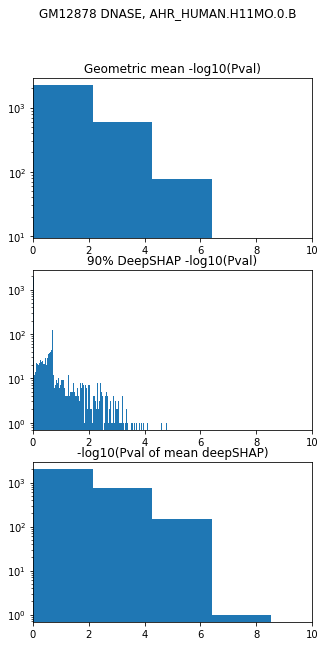

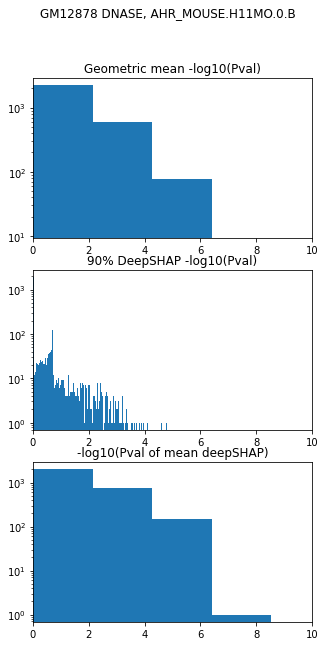

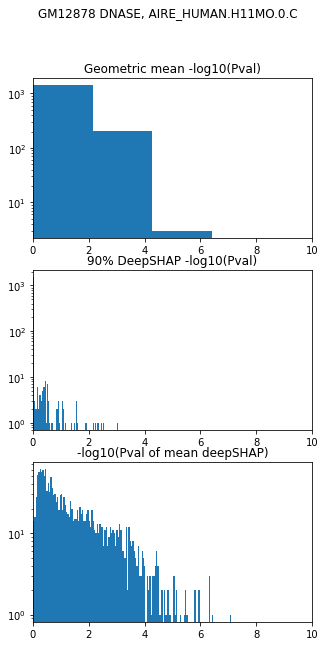

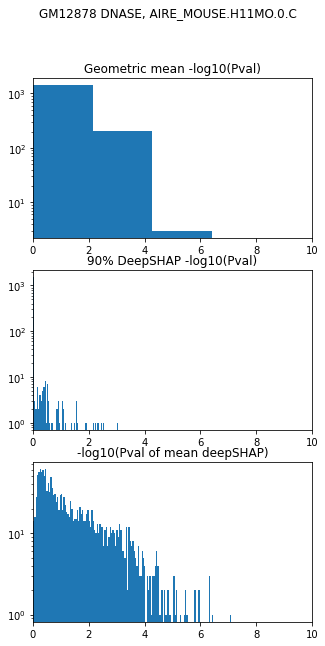

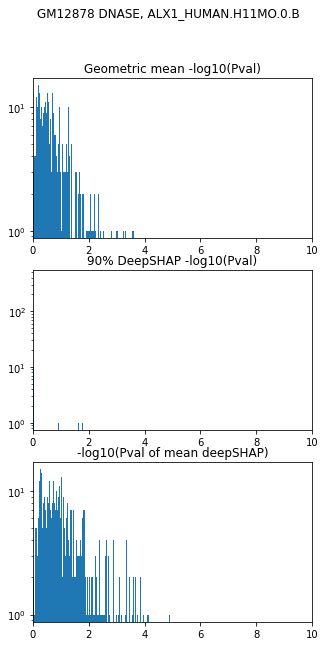

...

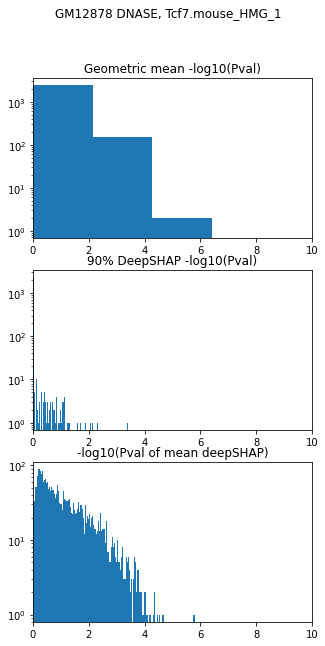

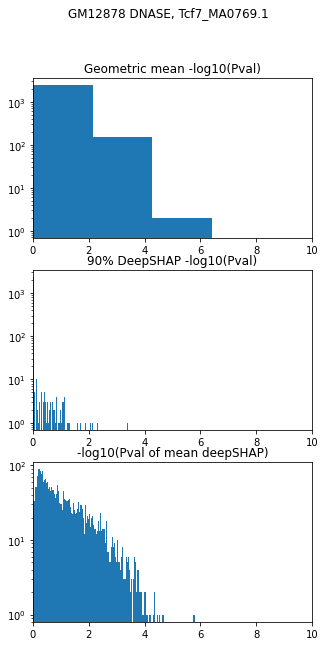

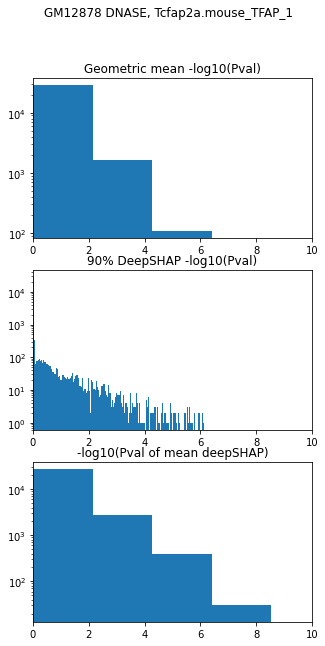

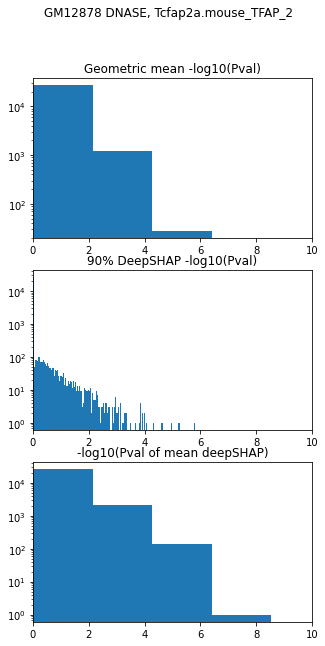

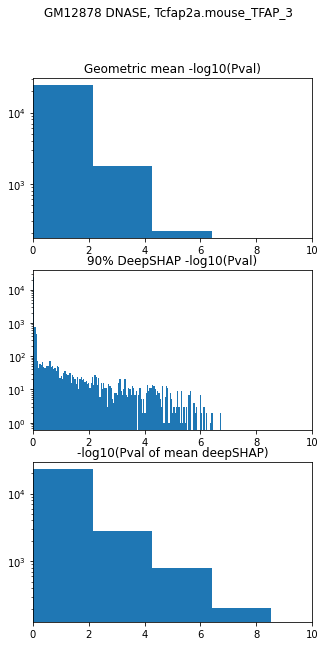

In [55]:
plt.rcParams["figure.figsize"]=5,10
for key in keys:
    print(str(key))
    fig, axes = plt.subplots(3, 1)
    cur_to_geom_mean_pval=tf_to_geom_mean_pval[key]
    cur_to_90_percentile_pval=tf_to_90_percentile_pval[key]
    cur_to_pval_of_mean=tf_to_pval_of_mean[key]
    axes[0].hist(cur_to_geom_mean_pval,bins=150)
    axes[0].set_title("Geometric mean -log10(Pval)")
    axes[1].hist(cur_to_90_percentile_pval,bins=150)
    axes[1].set_title("90% DeepSHAP -log10(Pval)")
    axes[2].hist(cur_to_pval_of_mean,bins=150) 
    axes[2].set_title("-log10(Pval of mean deepSHAP)")
    axes[0].set_yscale('log')
    axes[1].set_yscale('log')
    axes[2].set_yscale('log')
    axes[0].set_xlim(0,10)
    axes[1].set_xlim(0,10)
    axes[2].set_xlim(0,10)
    plt.suptitle(cell+' DNASE, '+str(key))
    plt.savefig(key.replace('/','-')+'.'+cell+'.idr.png')